In [3]:
library('dclone')
library('rjags')
library('snow')

# prepare data

# biz <- c(30, 0, 0, 50, 0, 20, 0, 0, 120, 0, 0, 0, 80, 0)
biz <- c(rep(0,11),
         14,
         0, 0,
         34.5,
         5,
         25,
         225,
         0,0, 0,0,
         90,
         68.5,
         0,
         50,
         0,0,
         241,
         0, 50,0,0,0,0)


# model

m <- NA
cluster <- NA

chains <- 4
nodes <- 4


runbiz <- function (biz,
                    chains = 4,
                    nodes = 4) {
        
        biz2 <- biz[biz>0]
        zero <- length(biz) - length(biz2)
        
        m <- NA
        cluster <- NA
        
        cluster <- makeCluster(spec = nodes,
                               type = "SOCK")
        
        system.time (m <- jags.parfit(cl = cluster,
                                      model = 'biz2.bug',
                                      data = list('biz2' = biz2, 'zero' = zero),
                                      n.chains = chains,
                                      n.adapt = 1000,
                                      params = c('p', 'm'),
                                      n.iter = 20000))
        stopCluster(cluster)
                
        m
}


runmul <- function (b = biz, steps = 3, do.plot = FALSE) {
        
        N = length(b)
        
        models <- list()
    
        for (i in 1:(steps)) {
                deb <- round(N*(i-1)/(steps+1)+1)
                fin <- round(N*(i+1)/(steps+1))
                m <- runbiz(b[deb:fin])
                print (summary(m))
                if (do.plot) plot(m)
                models[[i]] <- m
        }
    
        models
}


Parallel computation in progress


Iterations = 2001:22000
Thinning interval = 1 
Number of chains = 4 
Sample size per chain = 20000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

     Mean      SD  Naive SE Time-series SE
m 18.1457 16.4615 0.0582001      0.0603862
p  0.7002  0.1002 0.0003544      0.0003544

2. Quantiles for each variable:

   2.5%    25%     50%     75%   97.5%
m 2.500 8.4516 14.0742 22.7070 57.4614
p 0.487 0.6343  0.7067  0.7729  0.8748


Parallel computation in progress


Iterations = 2001:22000
Thinning interval = 1 
Number of chains = 4 
Sample size per chain = 20000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

     Mean      SD  Naive SE Time-series SE
m 30.3518 16.8798 0.0596793        0.06397
p  0.5262  0.1113 0.0003936        0.00039

2. Quantiles for each variable:

    2.5%     25%    50%     75%   97.5%
m 9.1867 19.0785 26.999 37.5345 70.8983
p 0.3084

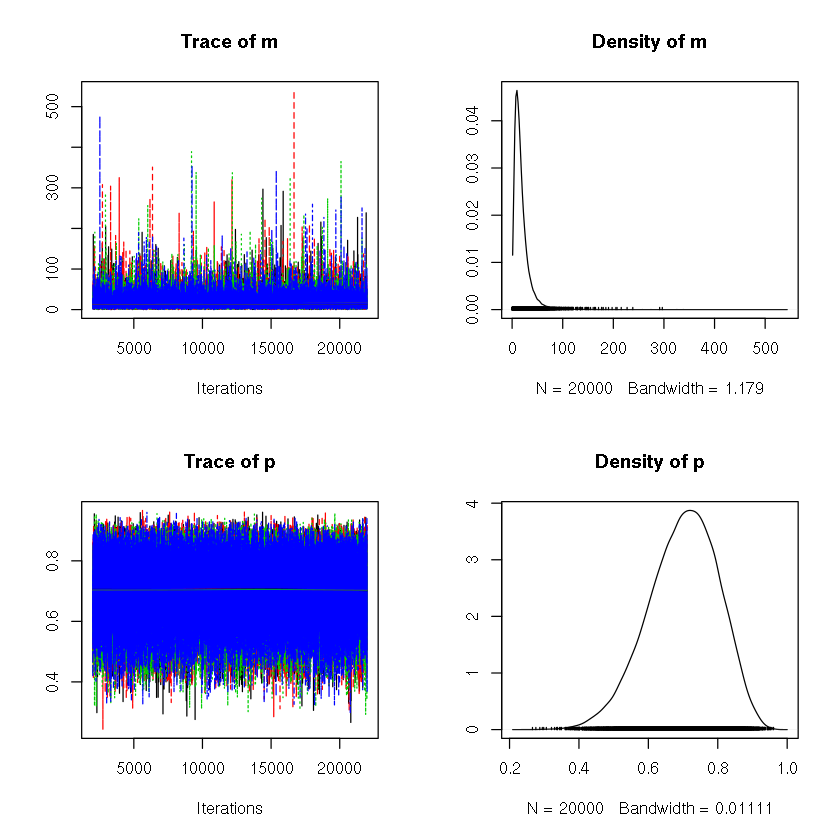


Parallel computation in progress


Iterations = 2001:22000
Thinning interval = 1 
Number of chains = 4 
Sample size per chain = 20000 

1. Empirical mean and standard deviation for each variable,
   plus standard error of the mean:

   Mean      SD  Naive SE Time-series SE
m 42.36 20.4101 0.0721607      0.0754797
p  0.65  0.1038 0.0003669      0.0003657

2. Quantiles for each variable:

     2.5%     25%     50%     75%   97.5%
m 14.2257 28.3155 38.7763 52.1614 91.5425
p  0.4359  0.5807  0.6547  0.7247  0.8376



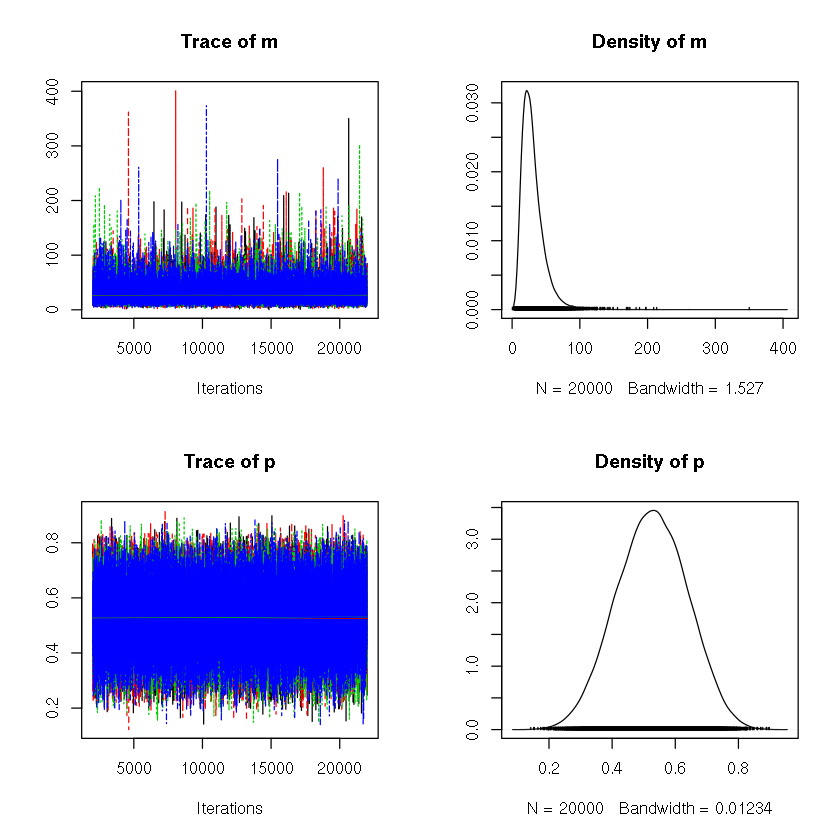

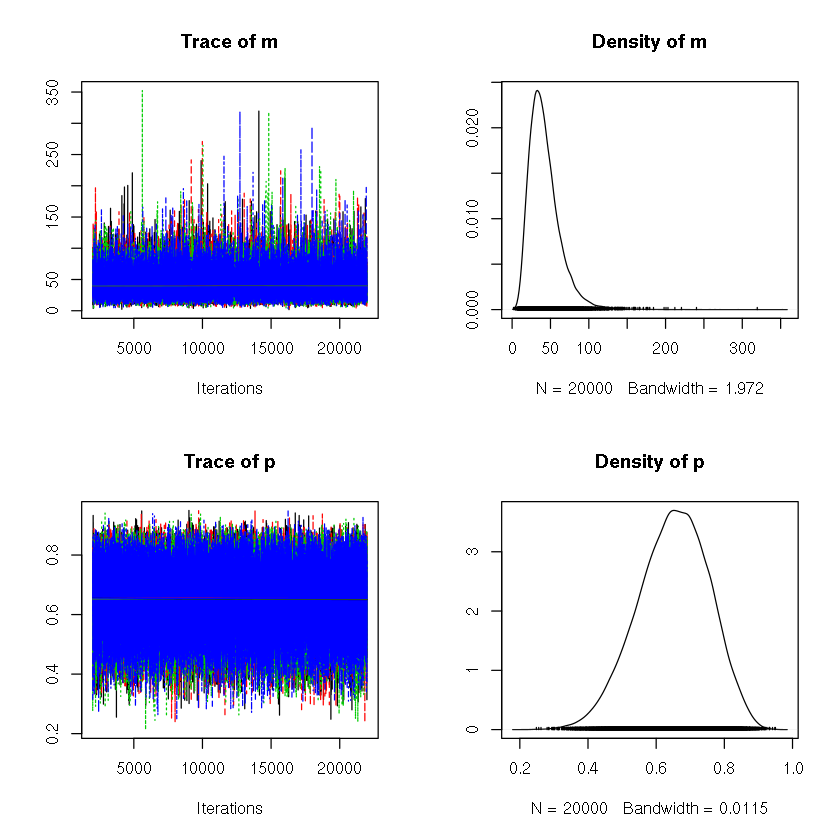

In [4]:
mul <- runmul()
plot(mul[[3]])